In [13]:
import pandas as pd
from sklearn.tree import DecisionTreeClassifier # Import Decision Tree Classifier
from sklearn.model_selection import train_test_split, cross_val_predict, learning_curve # Import train_test_split function
from sklearn import metrics #Import scikit-learn metrics module for accuracy calculation
from sklearn.preprocessing import LabelEncoder
from sklearn.externals.six import StringIO
from IPython.display import Image
from sklearn.tree import export_graphviz
import pydotplus
from sklearn.metrics import r2_score, accuracy_score
import numpy as np
import matplotlib.pyplot as plt

In [14]:
spear = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/data-spear.csv")
enron = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/data-enron.csv")

In [15]:
data = pd.concat([spear,enron],ignore_index=True)

In [16]:
row1 = data.iloc[:, [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 16]]
row2 = data.iloc[:, 15]

In [17]:
data=pd.concat([row2, row1], axis=1)

In [18]:
le = LabelEncoder()
le.fit(data.iloc[:,6])
data.iloc[:,6] = le.transform(data.iloc[:,6])

In [19]:
data=data.astype(int)

In [20]:
X=data.iloc[:, 1:]
Y=data.iloc[:, 0]

In [22]:
x_train, x_test, y_train, y_test= train_test_split(X,Y, test_size=1/5, random_state=0)

##criterion :'gini' , splitter ='best'

In [34]:
clf = DecisionTreeClassifier(criterion="gini", splitter='best')

In [35]:
clf = clf.fit(x_train,y_train)

In [36]:
y_pred = clf.predict(x_test)

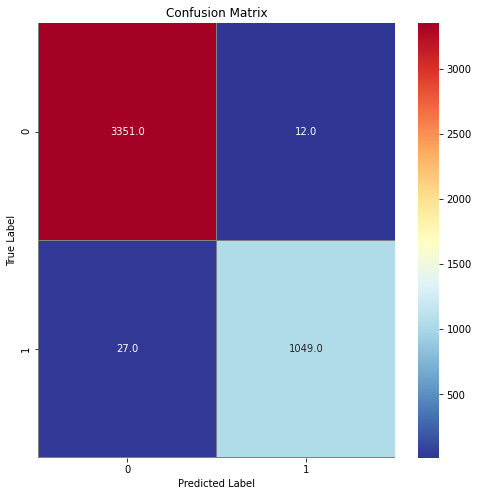

In [37]:
import seaborn as sns
import numpy as np
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_test, y_pred)

Y_pred = clf.predict(x_test)
Y_pred_classes = np.argmax(Y_pred) 
Y_true = np.argmax(y_test) 
f,ax = plt.subplots(figsize=(8, 8))
sns.heatmap(cm, annot=True, linewidths=0.01,cmap="RdYlBu_r",linecolor="gray", fmt= '.1f',ax=ax)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

In [38]:
from sklearn.metrics import precision_score
from sklearn.metrics import f1_score
from sklearn.metrics import recall_score
from sklearn.metrics import accuracy_score

Accuracy_Score = accuracy_score(y_test, y_pred)
Precision_Score = precision_score(y_test, y_pred,  average="macro")
Recall_Score = recall_score(y_test, y_pred,  average="macro")
F1_Score = metrics.f1_score(y_test, y_pred,  average="macro")

In [39]:
print(Accuracy_Score)
print(Precision_Score)
print(Recall_Score)
print(F1_Score)

0.991214237440865
0.9903485099850504
0.9856694102782633
0.9879823126098146


In [40]:
feature_cols = ["@ in URLs", "Attachments", "Css", "Dangerous Body", "Dangerous Subject", "Encoding","File", "External Resources", "Flash content", "HTML content",
                "Html Form", "Html iFrame", "IPs in URLs", "Javascript", "URLs"]

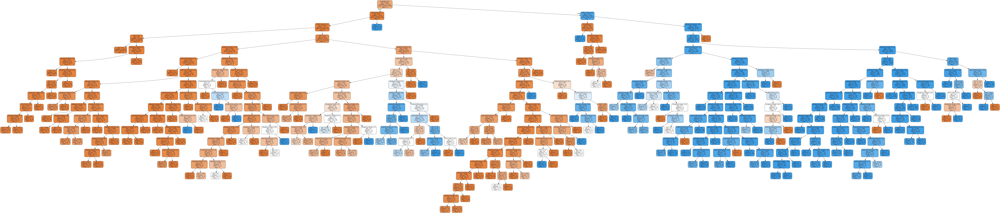

In [41]:
dot_data = StringIO()
export_graphviz(clf, out_file=dot_data,
                filled=True, rounded=True,
                special_characters=True, feature_names = feature_cols,class_names=['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
graph.write_png('PhishingTree.png')
Image(graph.create_png())

## criterion :'gini' , splitter ='random'

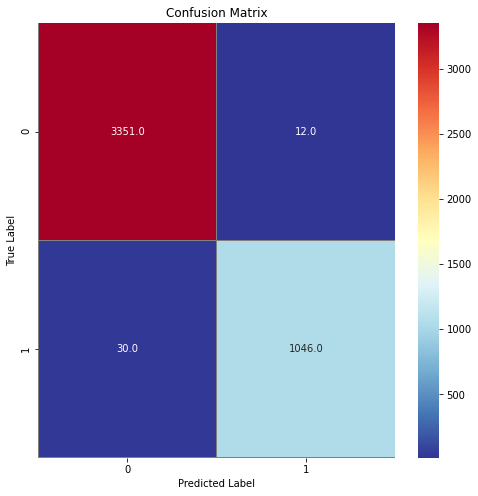

0.9905384095517008
0.9898923652636857
0.9842753582336535
0.9870454462073128


In [43]:
clf = DecisionTreeClassifier(criterion="gini", splitter='random')
clf = clf.fit(x_train,y_train)
y_pred = clf.predict(x_test)

cm = confusion_matrix(y_test, y_pred)

Y_pred = clf.predict(x_test)
Y_pred_classes = np.argmax(Y_pred) 
Y_true = np.argmax(y_test) 
f,ax = plt.subplots(figsize=(8, 8))
sns.heatmap(cm, annot=True, linewidths=0.01,cmap="RdYlBu_r",linecolor="gray", fmt= '.1f',ax=ax)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

Accuracy_Score = accuracy_score(y_test, y_pred)
Precision_Score = precision_score(y_test, y_pred,  average="macro")
Recall_Score = recall_score(y_test, y_pred,  average="macro")
F1_Score = metrics.f1_score(y_test, y_pred,  average="macro")
print(Accuracy_Score)
print(Precision_Score)
print(Recall_Score)
print(F1_Score)

In [44]:
dot_data = StringIO()
export_graphviz(clf, out_file=dot_data,
                filled=True, rounded=True,
                special_characters=True, feature_names = feature_cols,class_names=['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
graph.write_png('PhishingTree.png')
Image(graph.create_png())

##criterion :'entropy' , splitter ='best'

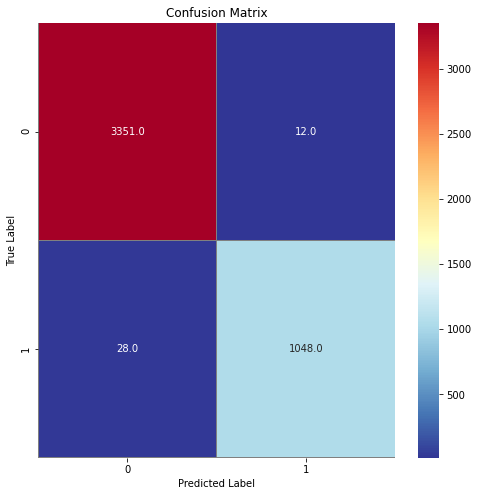

0.9909889614778103
0.990196384997236
0.9852047262633934
0.9876702253301736


In [50]:
clf = DecisionTreeClassifier(criterion="entropy", splitter='best')
clf = clf.fit(x_train,y_train)
y_pred = clf.predict(x_test)

cm = confusion_matrix(y_test, y_pred)

Y_pred = clf.predict(x_test)
Y_pred_classes = np.argmax(Y_pred) 
Y_true = np.argmax(y_test) 
f,ax = plt.subplots(figsize=(8, 8))
sns.heatmap(cm, annot=True, linewidths=0.01,cmap="RdYlBu_r",linecolor="gray", fmt= '.1f',ax=ax)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

Accuracy_Score = accuracy_score(y_test, y_pred)
Precision_Score = precision_score(y_test, y_pred,  average="macro")
Recall_Score = recall_score(y_test, y_pred,  average="macro")
F1_Score = metrics.f1_score(y_test, y_pred,  average="macro")
print(Accuracy_Score)
print(Precision_Score)
print(Recall_Score)
print(F1_Score)

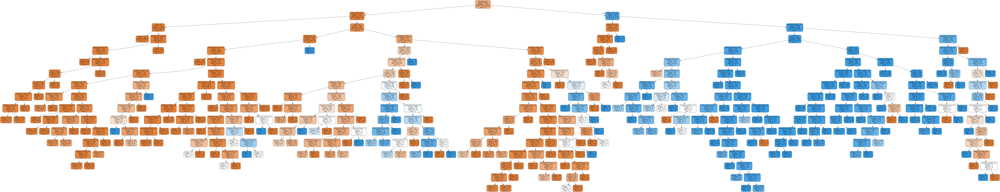

In [51]:
dot_data = StringIO()
export_graphviz(clf, out_file=dot_data,
                filled=True, rounded=True,
                special_characters=True, feature_names = feature_cols,class_names=['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
graph.write_png('PhishingTree.png')
Image(graph.create_png())

##criterion :'entropy' , splitter ='random'

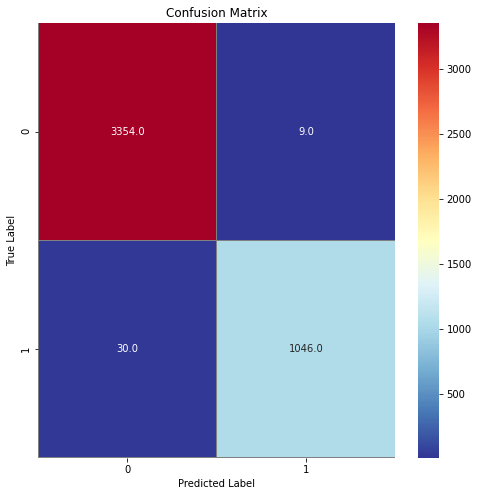

0.991214237440865
0.9913019730429229
0.984721388563716
0.9879591930841989


In [52]:
clf = DecisionTreeClassifier(criterion="entropy", splitter='random')
clf = clf.fit(x_train,y_train)
y_pred = clf.predict(x_test)

cm = confusion_matrix(y_test, y_pred)

Y_pred = clf.predict(x_test)
Y_pred_classes = np.argmax(Y_pred) 
Y_true = np.argmax(y_test) 
f,ax = plt.subplots(figsize=(8, 8))
sns.heatmap(cm, annot=True, linewidths=0.01,cmap="RdYlBu_r",linecolor="gray", fmt= '.1f',ax=ax)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

Accuracy_Score = accuracy_score(y_test, y_pred)
Precision_Score = precision_score(y_test, y_pred,  average="macro")
Recall_Score = recall_score(y_test, y_pred,  average="macro")
F1_Score = metrics.f1_score(y_test, y_pred,  average="macro")
print(Accuracy_Score)
print(Precision_Score)
print(Recall_Score)
print(F1_Score)

In [53]:
dot_data = StringIO()
export_graphviz(clf, out_file=dot_data,
                filled=True, rounded=True,
                special_characters=True, feature_names = feature_cols,class_names=['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
graph.write_png('PhishingTree.png')
Image(graph.create_png())